CSU DSCI 369 Lab 3
Instructor: Emily J. King
Spring 2024

Note: Run this lab one cell at a time due to sound files being played.  Need to install matplotlib.

Goals: Visualize how moving averages can smooth out local fluctuations. Hear how basic linear algebra operations affect song vectors.

Additional files needed: DSCI369sound., 
in the same folder as this ipynb file or the path. (We have not discussed the path.  If you don't know what "path" means, just make sure the two files are in the same folder.)

In [1]:
import numpy as np
import matplotlib.pyplot as plt

Section 1: Plotting small vectors

In [2]:
a=np.array([1, 3, -1, -2, 4, 3])

Plotting the above vector.

To plot a vector in Matplotlib like the graph of a function, simply use plt.plot(VECTOR).  The '-o' tells Matplotlib to add markers at the vector values, and then connect consective entries with line segments, which is useful for visualization of small vectors.  

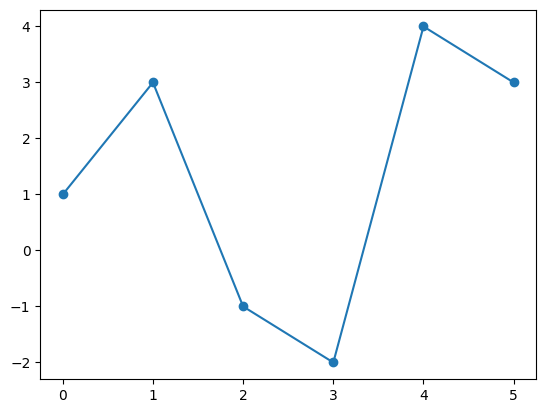

In [3]:
plt.plot(a,'-o')

Another vector.

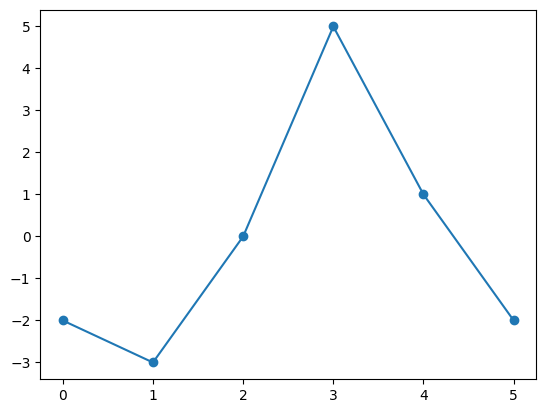

In [4]:
b=np.array([-2, -3, 0, 5, 1, -2])
plt.plot(b,'-o')

Plotting the sum of the two vectors above with the vectors themselves.

Note that once one starts doing more sophisticated things with Matplotlib, one normally needs to get the current axes via ax=plt.gca().

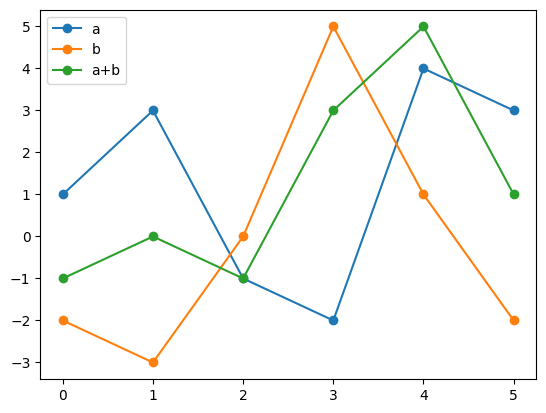

In [5]:
ax = plt.gca()
plt.plot(a,'-o',label='a')
plt.plot(b,'-o',label='b')
plt.plot(a+b,'-o',label='a+b')
ax.legend()

Plotting 0.5a, a, and 2a together.

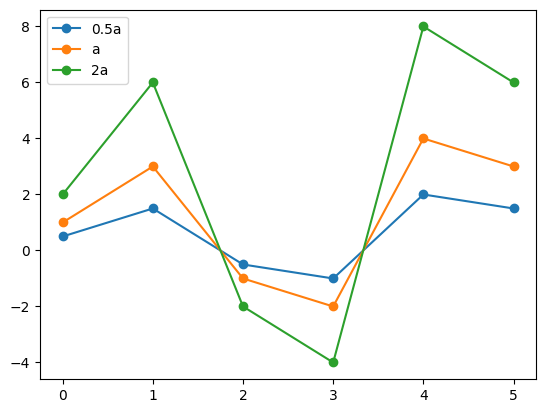

In [6]:
ax = plt.gca()
plt.plot(0.5*a,'-o',label='0.5a')
plt.plot(a,'-o',label='a')
plt.plot(2*a,'-o',label='2a')
ax.legend()

Section 2: Moving Averages

Generate sine wave vector with 100 entries and visualize it.  


(-1.2, 1.2)

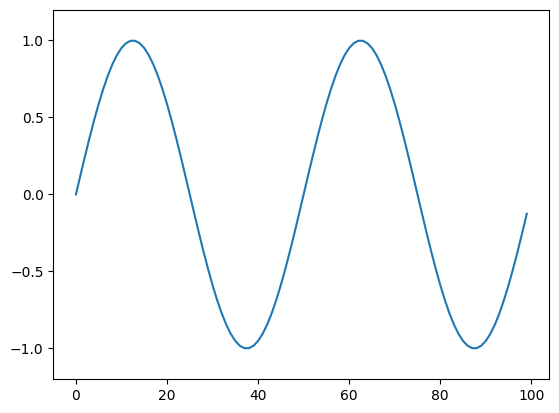

In [9]:
s=np.sin(2*np.pi*np.arange(100)/50)

plt.plot(s)
plt.ylim([-1.2,1.2])

Generate noise vector with 100 entries and visualize it. (For those who have had stats, np.random.normal(0,1,k) generates an array with k elements where each entry is a draw from the standard normal/Gaussian distribution.  If you haven't had stats, no worries, just think of randn as making noise.)

(-1.2, 1.2)

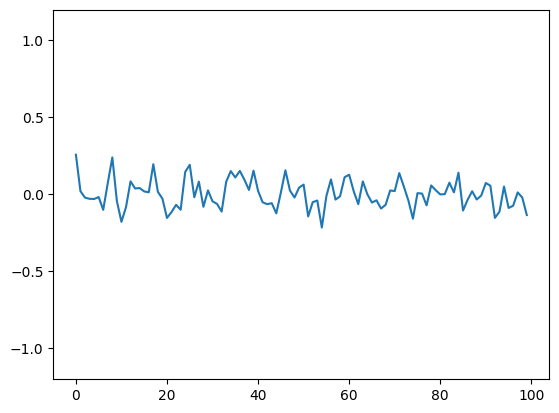

In [10]:
n=0.1*np.random.normal(0,1,100)

plt.plot(n)
plt.ylim([-1.2,1.2])

Make a noisy sine wave vector by adding the previous two vectors.  Then visualize the new vector.

(-1.2, 1.2)

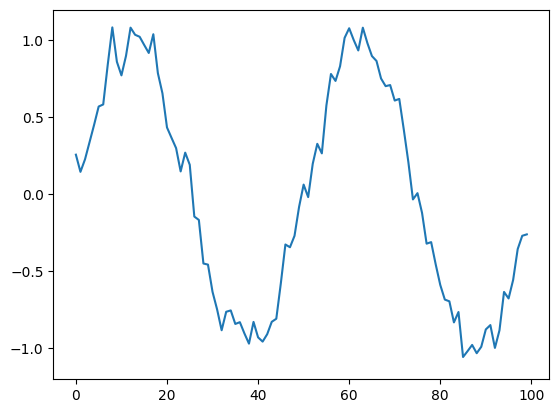

In [11]:
ns=s+n

plt.plot(ns)
plt.ylim([-1.2,1.2])

Visualize the moving average with a window of length 3. 

To compute the moving average of window length K, use np.convolve(VECTOR,np.ones(K)/K,mode='valid').  mode='valid' tells Python to not come up for values at the endpoints.  For example, the first entry of a vector doesn't have any entries to the left of it, so you can't take an average of entries centered at the first entry. 

(-1.2, 1.2)

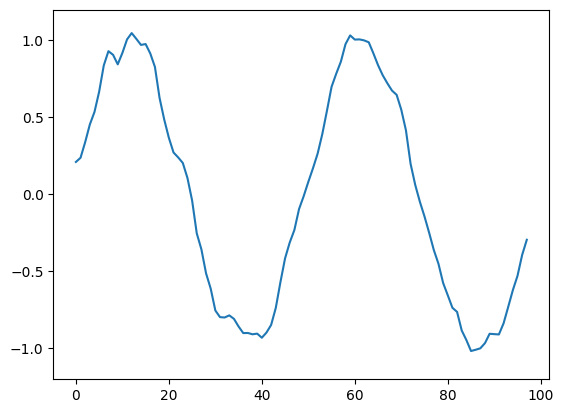

In [12]:
plt.plot(np.convolve(ns,np.ones(3)/3,mode='valid'))
plt.ylim([-1.2,1.2])

Discuss what you see.  

The new visualization is smoother than the noisy sine wave but is retaining the same basic shape.

Now, visualize the moving average with a window of length 9.

(-1.2, 1.2)

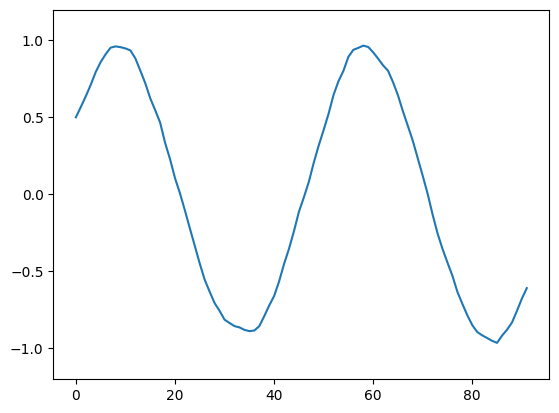

In [13]:
plt.plot(np.convolve(ns,np.ones(9)/9,mode='valid'))
plt.ylim([-1.2,1.2])

Discuss the difference between the last two plots.

Using a larger window length of 9 makes the noisy sine graph even more smoother and it almost looks like the original sine graph.  As the window length increases, the start and end of the graph appears to shift up and down respectively.

Now, visualize the moving average with a window of length 50.

(-1.2, 1.2)

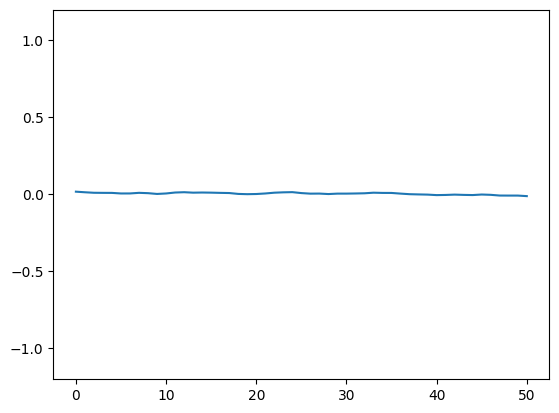

In [14]:
plt.plot(np.convolve(ns,np.ones(50)/50,mode='valid'))
plt.ylim([-1.2,1.2])

Discuss what you see and why you think it may have happened.

In the original sine graph, there are two wavelengths worth of data.  A window lengh of 50 is exactly one wavelength since the full length of the vector is 100 entries.  The average of one sine wavelength would be zero, so using 50 as the window length makes the entire visualization zero.


Section 3: Plotting and playing song vectors

In [15]:
from IPython.display import Audio

In [16]:
npzfile=np.load('DSCI369sound.npz')
locals().update(npzfile)


Song credits:

x = clip from King Gizzard and the Lizard Wizard - Flightless Records - 2017
y = clip from Björk - Hunter - OLI Records - 1998
z = clip from Black Star - Definition - Rawkus Records - 1999
u = clip from Johnny Cash - So Doggone Lonesome - Sun Records - 1955
v = clip from Vicente Fernández - Guadalajara (remasterizado) - 2006

In Python, anything to the right of a hash sign is ignored.  This is called a comment.  If you want to play around with your own sound files, remove the hash signs on the left hand side of each line in the following block of code and modify the file names. 
It's possible you might need to do more on the command line than the two %pip lines below to get these packages working in Jupyter, as I personally had to do more.  However, neither Tatum nor I are tech support.  If you can't figure it out, then just use the songs provided.
Replace y and ysr with z and zsr, respectively, in the code below to import in two different files and compare them as in code that follows.  Double check that ysr and zsr are both equal to 44100.  If not, you'll need to change the rate in the audio calls.

In [ ]:
#%pip install audio2numpy # if needed.   
#%pip install ffmpeg # if needed

#import audio2numpy as a2n
#y,ysr=a2n.audio_from_file("YOUR MP3, WAV, or AIFF")
#L=1000001
#y=y[:L,]

Visualize song y.

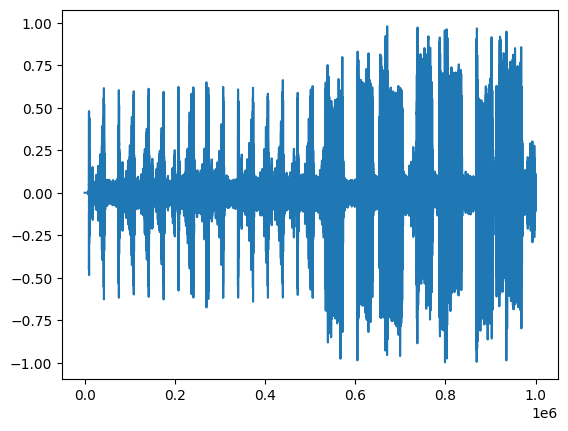

In [17]:
plt.plot(y[:,1])

Play song y.

(Jupyter's audio function doesn't seem to support two-channel audio or entering the rate as a variable.  Hence, if you import your own audio, make sure to only play one channel and double check that the rate (xsr) is still 441000.)

In [18]:
Audio(y[:,1], rate=44100) 

Visualize song z.

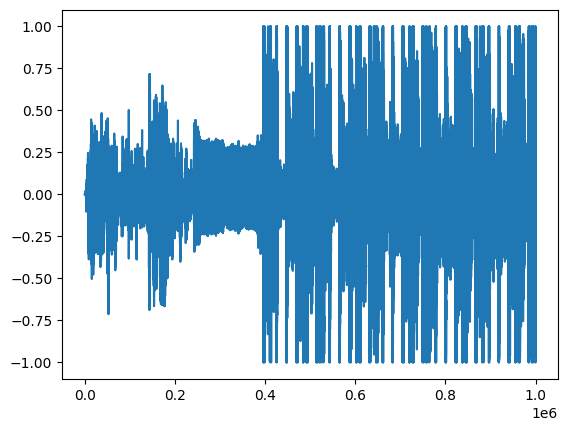

In [19]:
plt.plot(z[:,1])

Listen to song z.

In [20]:
Audio(z[:,1], rate=44100) 

Visualize 0.25 times z.

(-1.0, 0.999969482421875)

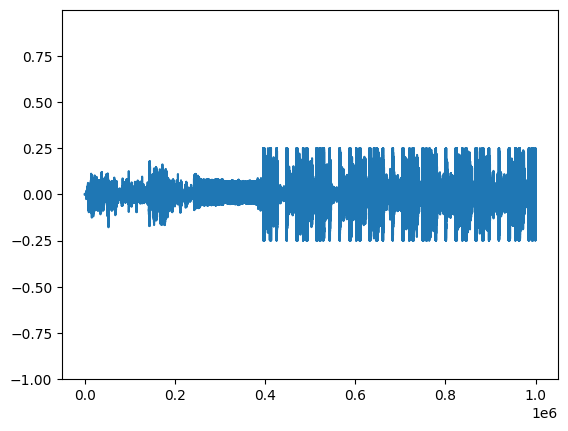

In [21]:
plt.plot(0.25*z[:,1])
plt.ylim([np.min(z),np.max(z)])

Listen to 0.25 times z.

(Jupyter audio automatically rescales all volume and has no option to not do that.  Hence, the weird hack in the code below with quietz.  Unfortunately, this hack won't allow you to hear the effect of multiplying songs by numbers greater than 1.)

In [22]:
quietz=0.25*z[:,1]
quietz[0]=1
Audio(quietz, rate=44100) 

Plot 0.25*z + y.

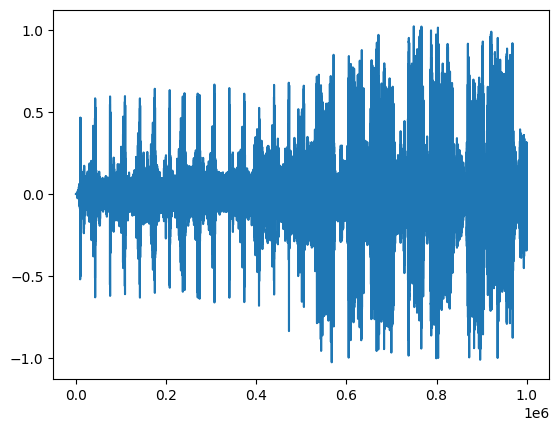

In [23]:
plt.plot(0.25*z[:,1]+y[:,1])

Listen to 0.25*z + y.

In [24]:
Audio(0.25*z[:,1]+y[:,1], rate=44100) 

Lab 3 Exercises

1. Choose a pair of songs, two from the files loaded from DSCI369sound.npz, two of your own loaded using the commented out code, or a mixture. Call the song vectors song1 and song2. 

In [26]:
song1 = y
song2 = z

2. Compute and listen to three different linear combinations of the songs.

In [56]:
# First Combination
Audio(0.10*song1[:,1] + 0.05*song2[:,1], rate=44100) 

In [57]:
# Second Combination
Audio(-1*song2[:,1] + song2[:,1], rate=44100) 

/Users/wyatt/Documents/dsci-369-labs/venv/lib/python3.9/site-packages/IPython/lib/display.py:187: RuntimeWarning: invalid value encountered in divide
  scaled = data / normalization_factor * 32767
/Users/wyatt/Documents/dsci-369-labs/venv/lib/python3.9/site-packages/IPython/lib/display.py:188: RuntimeWarning: invalid value encountered in cast
  return scaled.astype("<h").tobytes(), nchan


In [54]:
# Third Combination
Audio(song1[:,1]*song2[:,1], rate=44100) 

3. Plot the moving averages of song1 with window lengths of 101 and 1001 using the code below. The ends are trimmed off so that all of the vectors are the same length.

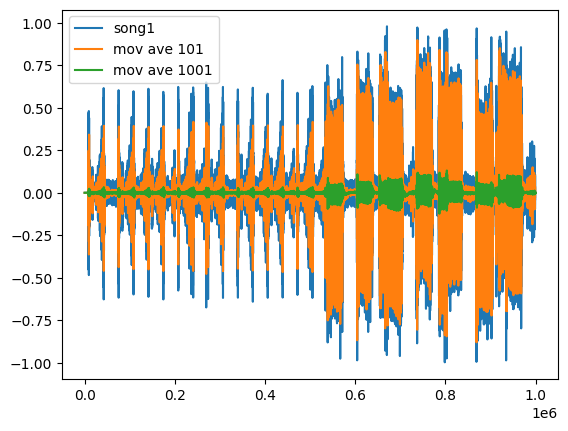

In [40]:
song1_ma101=np.convolve(song1[:,1],np.ones(101)/101,mode='full')
song1_ma1001=np.convolve(song1[:,1],np.ones(1001)/1001,mode='full')

ax = plt.gca()
plt.plot(song1[500:-500,1],label='song1')
plt.plot(song1_ma101[500:-500],label='mov ave 101')
plt.plot(song1_ma1001[500:-500],label='mov ave 1001')
ax.legend()

Now listen to the moving averages.  If you don't hear anything the first time through, turn up your volume and play again.

Note if you use your own songs and the xsr shown during import is not equal to 44,100, then you will need to update the rate in the following commands.

First the original song.

In [55]:
Audio(song1[:,1], rate=44100) 

Next the moving average with window of length 101.

In [42]:
song1_ma101[500]=1 # hack to prevent Jupyter from rescaling volume

Audio(song1_ma101[500:-500], rate=44100) 

Finally, the moving average with window of length 1001.

In [43]:
song1_ma1001[500]=1 # hack to prevent Jupyter from rescaling volume

Audio(song1_ma1001[500:-500], rate=44100) 

Between the plots and the sounds, what are the moving averages doing to the song file?

The moving averages seem to be emphasizing the repetitive parts of the song (mainly the repeating bass line) while making the less repetitive parts quiet.  With a window length of 1001, the song is barely audible except for that repeating bass line.